# Nicaragua's Public Investment Program (PIP) Analysis

In [1]:
import pandas as pd
import numpy as np
import geopandas
import matplotlib.pyplot as plt
import seaborn as sns

## Reading the dataset file 

In [2]:
pip_17_22 = pd.read_csv('/Users/leona/Documents/Python/Programa Inversiones Publicas/PIP_2017-2022.csv')

In [3]:
pip_17_22.columns

Index(['Unnamed: 0', 'ente', 'institucion', 'Municipio Espacial', 'Municipio',
       'Departamento', 'Column2', 'Sector', 'proyecto', 'obra', 'fuente',
       'Fuente financiamiento', 'Fuente financiamiento 2', 'Monto',
       'Recursos Propios', 'Recuros del Tesoro', 'Destino Específico',
       'Donación', 'Préstamo', 'Total', 'Año'],
      dtype='object')

## I. First thing to do before going to the analysis is cleaning the Dataframe

## 1. Dropping some useless columns

In [4]:
pip_17_22.drop(columns=['Unnamed: 0','Recursos Propios', 'Recuros del Tesoro', 'Destino Específico',
       'Donación', 'Préstamo','Total' ], axis=1, inplace=True)
pip_17_22.columns

Index(['ente', 'institucion', 'Municipio Espacial', 'Municipio',
       'Departamento', 'Column2', 'Sector', 'proyecto', 'obra', 'fuente',
       'Fuente financiamiento', 'Fuente financiamiento 2', 'Monto', 'Año'],
      dtype='object')

## 2. Renaming some columns

In [5]:
pip_17_22.rename(columns={"fuente": "Fuente de financiamiento",
                          "Fuente financiamiento": "Procedencia de la fuente", 
                          "Fuente financiamiento 2":"Tipo de financiamiento"}, inplace=True)
pip_17_22.head(2)

,ente,institucion,Municipio Espacial,Municipio,Departamento,Column2,Sector,proyecto,obra,Fuente de financiamiento,Procedencia de la fuente,Tipo de financiamiento,Monto,Año
0,Gobierno Central,MINISTERIO DE TRANSPORTE E INFRAESTRUCTURA,Camoapa,Camoapa,Boaco,Boaco,TRANSPORTE,REHABILITACIÓN DE CAMINOS INTERMUNICIPALES,Rehabilitación del camino La Embajada - Villa ...,Recursos del Tesoro,Fondos Internos,Recursos del Tesoro,7.965928,2022
1,Gobierno Central,MINISTERIO DE TRANSPORTE E INFRAESTRUCTURA,Camoapa,Camoapa,Boaco,Boaco,TRANSPORTE,REHABILITACIÓN DE CAMINOS INTERMUNICIPALES,Rehabilitación del camino Empalme Masigüe - La...,Recursos del Tesoro,Fondos Internos,Recursos del Tesoro,7.838681,2022


## 3. Drop "Column2" because is redundant

In [6]:
pip_17_22.drop("Column2", axis=1, inplace=True)
pip_17_22.columns

Index(['ente', 'institucion', 'Municipio Espacial', 'Municipio',
       'Departamento', 'Sector', 'proyecto', 'obra',
       'Fuente de financiamiento', 'Procedencia de la fuente',
       'Tipo de financiamiento', 'Monto', 'Año'],
      dtype='object')

In [7]:
pip_17_22.head(3)

,ente,institucion,Municipio Espacial,Municipio,Departamento,Sector,proyecto,obra,Fuente de financiamiento,Procedencia de la fuente,Tipo de financiamiento,Monto,Año
0,Gobierno Central,MINISTERIO DE TRANSPORTE E INFRAESTRUCTURA,Camoapa,Camoapa,Boaco,TRANSPORTE,REHABILITACIÓN DE CAMINOS INTERMUNICIPALES,Rehabilitación del camino La Embajada - Villa ...,Recursos del Tesoro,Fondos Internos,Recursos del Tesoro,7.965928,2022
1,Gobierno Central,MINISTERIO DE TRANSPORTE E INFRAESTRUCTURA,Camoapa,Camoapa,Boaco,TRANSPORTE,REHABILITACIÓN DE CAMINOS INTERMUNICIPALES,Rehabilitación del camino Empalme Masigüe - La...,Recursos del Tesoro,Fondos Internos,Recursos del Tesoro,7.838681,2022
2,Gobierno Central,MINISTERIO DE TRANSPORTE E INFRAESTRUCTURA,Camoapa,Camoapa,Boaco,TRANSPORTE,REHABILITACIÓN DE CAMINOS INTERMUNICIPALES,Rehabilitación del camino Villa Revolución - S...,Recursos del Tesoro,Fondos Internos,Recursos del Tesoro,6.974426,2022


### After done this, we have our final dataset to be analyzed.
### But first, we need to check for the Dataframe structure.

In [8]:
pip_17_22.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11217 entries, 0 to 11216
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ente                      11217 non-null  object 
 1   institucion               11217 non-null  object 
 2   Municipio Espacial        11217 non-null  object 
 3   Municipio                 11217 non-null  object 
 4   Departamento              11217 non-null  object 
 5   Sector                    11217 non-null  object 
 6   proyecto                  11217 non-null  object 
 7   obra                      11217 non-null  object 
 8   Fuente de financiamiento  11217 non-null  object 
 9   Procedencia de la fuente  11217 non-null  object 
 10  Tipo de financiamiento    11217 non-null  object 
 11  Monto                     11212 non-null  float64
 12  Año                       11217 non-null  int64  
dtypes: float64(1), int64(1), object(11)
memory usage: 1.1+ MB


**The information above show that all the columns, except 'Año' are detected as 'object', we are to convert them to category and strings**

In [9]:
cols = ['ente', 'institucion','Municipio Espacial', 'Municipio','Departamento', 'Sector',
       'Fuente de financiamiento', 'Procedencia de la fuente','Tipo de financiamiento']
cols2 = ['proyecto', 'obra']
pip_17_22[cols] = pip_17_22[cols].astype('category')
pip_17_22[cols2] = pip_17_22[cols2].astype('string')
pip_17_22.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11217 entries, 0 to 11216
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   ente                      11217 non-null  category
 1   institucion               11217 non-null  category
 2   Municipio Espacial        11217 non-null  category
 3   Municipio                 11217 non-null  category
 4   Departamento              11217 non-null  category
 5   Sector                    11217 non-null  category
 6   proyecto                  11217 non-null  string  
 7   obra                      11217 non-null  string  
 8   Fuente de financiamiento  11217 non-null  category
 9   Procedencia de la fuente  11217 non-null  category
 10  Tipo de financiamiento    11217 non-null  category
 11  Monto                     11212 non-null  float64 
 12  Año                       11217 non-null  int64   
dtypes: category(9), float64(1), int64(1), string(2

## II. The first part of the analysis: How is the public investment distribuited along the Nicaraguan territory. In order to do this, we are going to show some visualizations: 

## 1. Total amount of investment for all the period.

In [10]:
print('The total amount of the PIP between 2017 and 2022 is:', pip_17_22.Monto.sum().round(2), 'millions of córdobas')

The total amount of the PIP between 2017 and 2022 is: 150784.46 millions of córdobas


## 2. Amount of investment per year

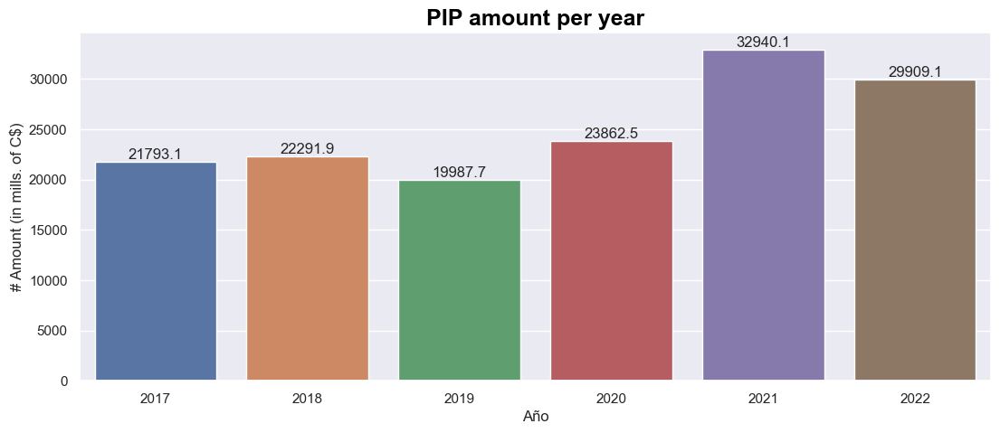

In [11]:
sns.set(rc={"figure.figsize":(13, 5)})

ax = sns.barplot(data=pip_17_22, x='Año', y='Monto', estimator='sum', errorbar=None)
ax.set_title('PIP amount per year', 
             fontdict={'fontsize':18, 'fontweight':'bold'}, color='black')
ax.set_ylabel("# Amount (in mills. of C$)")

for container in ax.containers:
    ax.bar_label(container)

## 3. Total Amount of investment by department

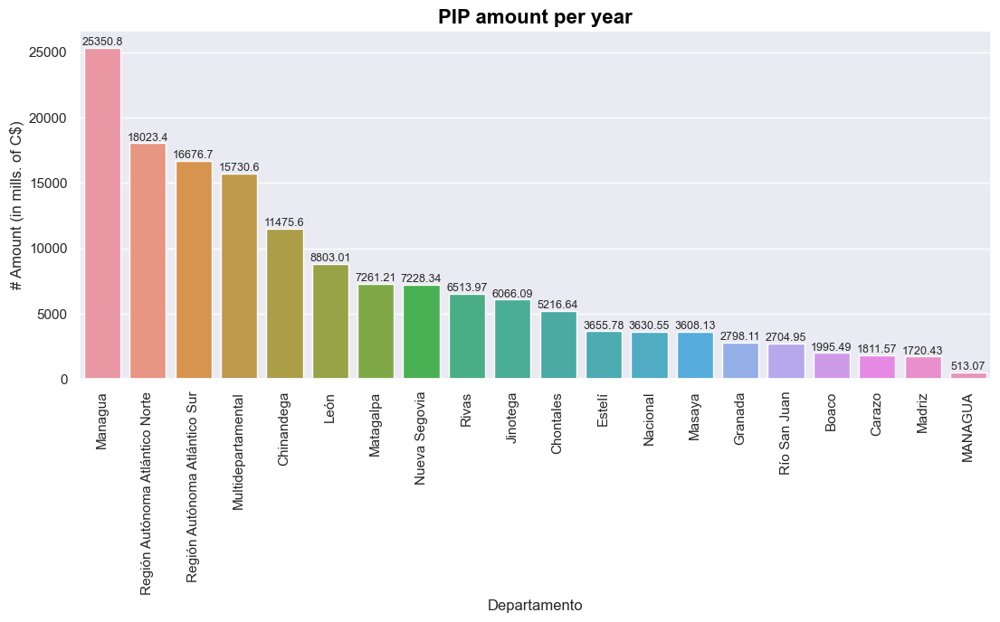

In [12]:
sns.set(rc={"figure.figsize":(13, 5)})
plot_order=pip_17_22.groupby('Departamento')['Monto'].sum().sort_values(ascending=False).index.values


ax = sns.barplot(data=pip_17_22, x='Departamento', y='Monto', estimator='sum', errorbar=None, order=plot_order)
ax.set_title('PIP amount per year', 
             fontdict={'fontsize':16, 'fontweight':'bold'}, color='black')
ax.set_ylabel("# Amount (in mills. of C$)")
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)

for container in ax.containers:
    ax.bar_label(container, fontsize=9)

**As we can see, There are 17 departments in Nicaragua, and 2 identified as "Nacional" and "Multidepartamental". These last 2 are projects presented in multiple locations in the country. But, we can see that there is a duplicated register in 'Managua' and 'MANAGUA'; in this case is necessary to change it.**

In [13]:
pip_17_22['Departamento'] = pip_17_22['Departamento'].str.replace('MANAGUA',"Managua")

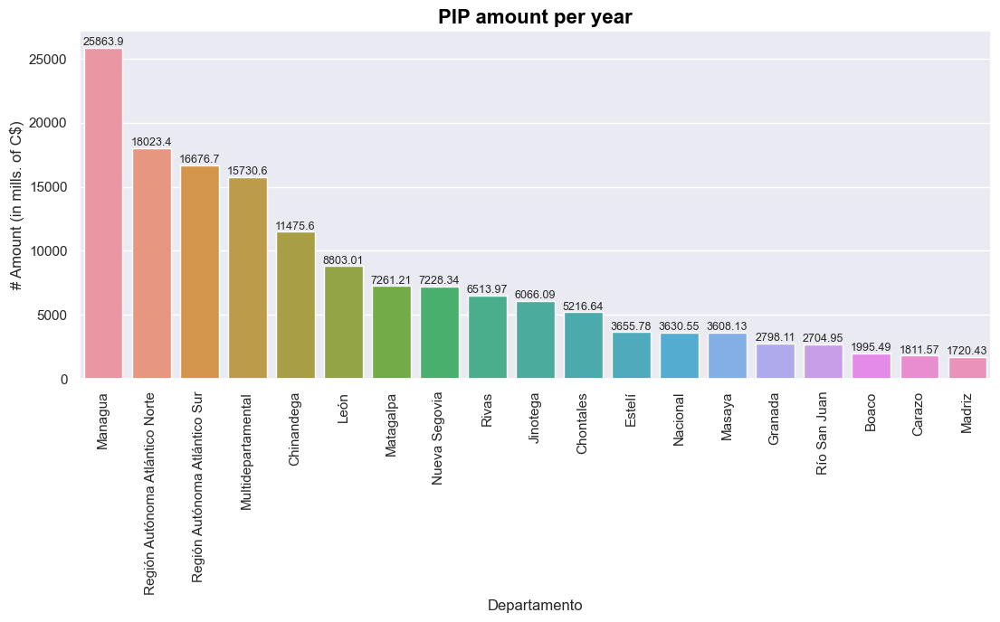

In [14]:
sns.set(rc={"figure.figsize":(13, 5)})
plot_order=pip_17_22.groupby('Departamento')['Monto'].sum().sort_values(ascending=False).index.values


ax = sns.barplot(data=pip_17_22, x='Departamento', y='Monto', estimator='sum', errorbar=None, order=plot_order)
ax.set_title('PIP amount per year', 
             fontdict={'fontsize':16, 'fontweight':'bold'}, color='black')
ax.set_ylabel("# Amount (in mills. of C$)")
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)

for container in ax.containers:
    ax.bar_label(container, fontsize=9)

In [139]:
pip_by_dept = pip_17_22.groupby('Departamento')['Monto'].sum().round(2).sort_values(ascending=False).reset_index()
pip_by_dept['% of total'] = (100*pip_by_dept.Monto / pip_by_dept.Monto.sum()).round(2)
pip_by_dept['cum %'] = pip_by_dept['% of total'].cumsum()
pip_by_dept

,Departamento,Monto,% of total,cum %
0,Managua,25863.90,17.15,17.15
1,Región Autónoma Atlántico Norte,18023.41,11.95,29.10
2,Región Autónoma Atlántico Sur,16676.68,11.06,40.16
3,Multidepartamental,15730.56,10.43,50.59
4,Chinandega,11475.65,7.61,58.20
5,León,8803.01,5.84,64.04
6,Matagalpa,7261.21,4.82,68.86
7,Nueva Segovia,7228.34,4.79,73.65
8,Rivas,6513.97,4.32,77.97
9,Jinotega,6066.09,4.02,81.99


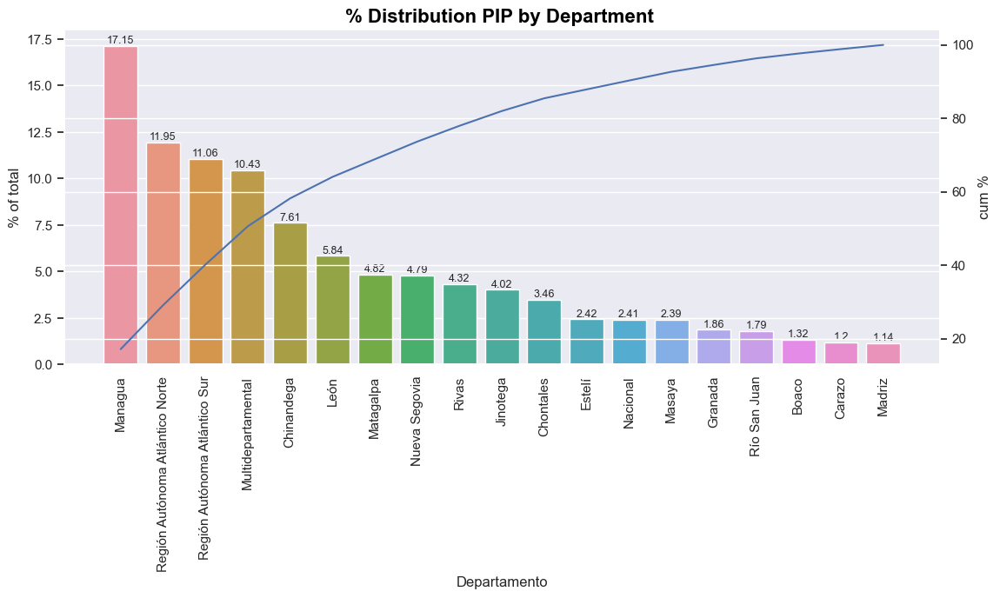

In [137]:
dd = sns.barplot(x='Departamento', y='% of total', data=pip_by_dept)
dd.set_xticklabels(dd.get_xticklabels(),rotation=90)
dd.set_title('% Distribution PIP by Department ', 
             fontdict={'fontsize':16, 'fontweight':'bold'}, color='black')
for container in dd.containers:
    dd.bar_label(container, fontsize=9)

ax2 = plt.twinx()
ld=sns.lineplot(data=pip_by_dept, x='Departamento', y='cum %', color="b", ax=ax2)
ld.line_label()
plt.show()


## 4. Total Amount of investment by municipality

In [114]:
pip_muni_top20=pip_17_22.groupby('Municipio')['Monto'].sum().round(2).sort_values(ascending=False).head(20).reset_index()
pip_muni_top20['% of total'] = (100*pip_muni_top20.Monto / pip_17_22.Monto.sum()).round(2)
pip_muni_top20.rename({'Municipio':'Municipio1'}, axis=1, inplace=True)
pip_muni_top20.head()

,Municipio1,Monto,% of total
0,Managua,18221.23,12.08
1,Multidepartamental,15730.56,10.43
2,RACCN (Intermunicipal),8153.35,5.41
3,León,6330.89,4.20
4,RACCS (Intermunicipal),5174.65,3.43


In [130]:
print('The top 20 municipalities have the ', pip_muni_top20['% of total'].sum(), 'of the total investments')

The top 20 municipalities have the  62.3 of the total investments


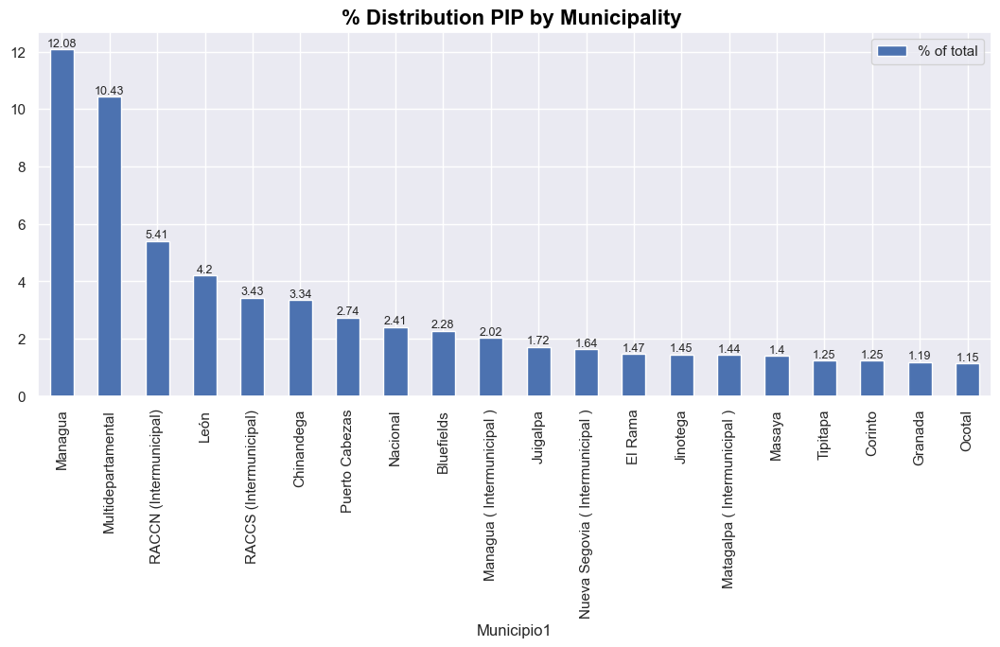

In [121]:
md = pip_muni_top20.plot.bar(x='Municipio1', y='% of total')
md.set_xticklabels(md.get_xticklabels(),rotation=90)
md.set_title('% Distribution TOP 20 PIP by Municipality ', 
             fontdict={'fontsize':16, 'fontweight':'bold'}, color='black')
for container in md.containers:
    md.bar_label(container, fontsize=9)

## 5. Municipalities with the lowest investment

In [131]:
bot20_pip = pip_17_22.groupby('Municipio')['Monto'].sum().round(2).sort_values(ascending=True).head(20).reset_index()
bot20_pip['% of total'] = (100*bot20_pip.Monto / pip_17_22.Monto.sum()).round(2)
bot20_pip.head()

,Municipio,Monto,% of total
0,León ( Intermunicipal ),6.20,0.00
1,Boaco (Intermunicipal ),7.00,0.00
2,Esteli( Intermunicipal ),10.69,0.01
3,Madriz ( Intermunicipal ),10.88,0.01
4,Carazo ( Intermunicipal ),12.90,0.01


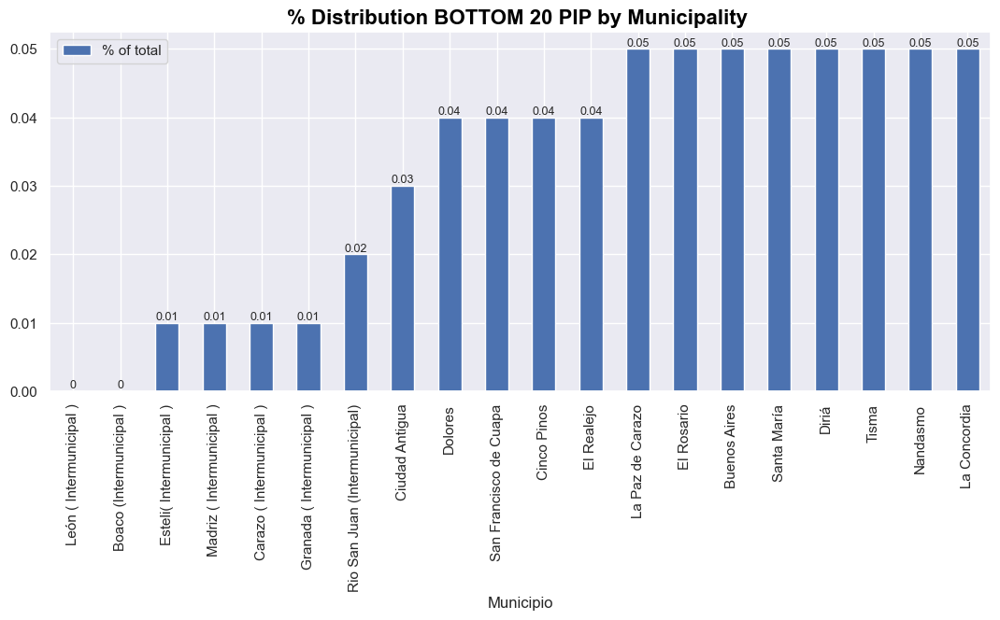

In [132]:
bd=bot20_pip.plot.bar(x='Municipio', y='% of total')
bd.set_xticklabels(bd.get_xticklabels(),rotation=90)
bd.set_title('% Distribution BOTTOM 20 PIP by Municipality ', 
             fontdict={'fontsize':16, 'fontweight':'bold'}, color='black')
for container in bd.containers:
    bd.bar_label(container, fontsize=9)

In [135]:
print('The bottom 20 municipalities have the ', bot20_pip['% of total'].sum().round(2),'% of the total investments')

The bottom 20 municipalities have the  0.65 % of the total investments


**As we could see in the last part, 64% of the total investment was aimed to the first 5 departments (out of 19).
On the other hand, The top 20 municipalities have the  62.3 of the total investments; whereas The bottom 20 municipalities have just the 0.65 % of the total investments.**

## III. Create an interactive map of the country showing all the 17 'departamentos' and 153 'municipios'.

### For that, is necessary use geopandas library, and create two differents GeoDataFrames: one for "municipios" and another for "departementos"

In [84]:
# First thing, import the geographic space file for "departamentos"

depto_nic = geopandas.read_file(
    '/Users/leona/Documents/Presupuestos/nic_admbnda_inide_itos_20210826_shp/nic_admbnda_adm1_inide_itos_20210826.shp')

depto_nic.head(3)

,Shape_Leng,Shape_Area,ADM1_ES,ADM1_PCODE,ADM1_REF,ADM1ALT1ES,ADM1ALT2ES,ADM0_ES,ADM0_PCODE,date,validOn,validTo,geometry
0,3.866337,0.347228,Boaco,NI50,None,None,None,Nicaragua,NI,2020-01-01,2021-08-26,None,"POLYGON ((-85.08157 12.80066, -85.08119 12.800..."
1,1.509944,0.090920,Carazo,NI75,None,None,None,Nicaragua,NI,2020-01-01,2021-08-26,None,"POLYGON ((-86.29325 11.95445, -86.29144 11.952..."
2,11.440740,0.394440,Chinandega,NI30,None,None,None,Nicaragua,NI,2020-01-01,2021-08-26,None,"MULTIPOLYGON (((-87.12136 12.45293, -87.12107 ..."


In [85]:
# Renaming some columns

depto_nic.rename(columns={"ADM1_ES": "Departamento", "ADM0_ES": "Pais", 
                          "ADM1_PCODE": "Dept_CODE","ADM0_PCODE": "Pais_CODE"}, inplace=True)
depto_nic.columns

Index(['Shape_Leng', 'Shape_Area', 'Departamento', 'Dept_CODE', 'ADM1_REF',
       'ADM1ALT1ES', 'ADM1ALT2ES', 'Pais', 'Pais_CODE', 'date', 'validOn',
       'validTo', 'geometry'],
      dtype='object')

In [86]:
# Dropping some useless columns

depto_nic.drop(['Shape_Leng','Shape_Area','ADM1_REF','ADM1ALT1ES','ADM1ALT2ES','date','validOn','validTo'], axis=1, inplace=True)
depto_nic.head(3)

,Departamento,Dept_CODE,Pais,Pais_CODE,geometry
0,Boaco,NI50,Nicaragua,NI,"POLYGON ((-85.08157 12.80066, -85.08119 12.800..."
1,Carazo,NI75,Nicaragua,NI,"POLYGON ((-86.29325 11.95445, -86.29144 11.952..."
2,Chinandega,NI30,Nicaragua,NI,"MULTIPOLYGON (((-87.12136 12.45293, -87.12107 ..."


### Now, repeat the process for "municipios"

In [87]:
# import the geographic space file for municipios

munic_nic = geopandas.read_file(
    '/Users/leona/Documents/Presupuestos/nic_admbnda_inide_itos_20210826_shp/nic_admbnda_adm2_inide_20210826.shp')

munic_nic.head(3)                            


,Shape_Leng,Shape_Area,ADM2_ES,ADM2_PCODE,ADM2_REF,ADM2ALT1ES,ADM2ALT2ES,ADM1_ES,ADM1_PCODE,ADM0_ES,ADM0_PCODE,date,validOn,validTo,geometry
0,0.307594,0.005349,Ticuantepe,NI5530,None,None,None,Managua,NI55,Nicaragua,NI,2020-01-01,2021-08-26,None,"POLYGON ((-86.19081 11.98055, -86.24066 11.972..."
1,0.927891,0.032600,Achuapa,NI3505,None,None,None,León,NI35,Nicaragua,NI,2020-01-01,2021-08-26,None,"POLYGON ((-86.49226 13.11424, -86.49231 13.113..."
2,1.136116,0.034440,San Juan del Sur,NI8045,None,None,None,Rivas,NI80,Nicaragua,NI,2020-01-01,2021-08-26,None,"POLYGON ((-85.68629 11.20745, -85.70234 11.151..."


In [88]:
# Rename some columns names

munic_nic.rename(columns={"ADM2_ES": "Municipio", "ADM1_ES": "Departamento", "ADM0_ES": "Pais"}, inplace=True)
munic_nic.columns

Index(['Shape_Leng', 'Shape_Area', 'Municipio', 'ADM2_PCODE', 'ADM2_REF',
       'ADM2ALT1ES', 'ADM2ALT2ES', 'Departamento', 'ADM1_PCODE', 'Pais',
       'ADM0_PCODE', 'date', 'validOn', 'validTo', 'geometry'],
      dtype='object')

In [36]:
# Dropping some useless columns

munic_nic.drop(['Shape_Leng','Shape_Area','ADM2_REF','ADM2ALT1ES','ADM2ALT2ES'], axis=1, inplace=True)


In [37]:
munic_nic.drop(['date','validOn','validTo'], axis=1, inplace=True)
munic_nic.head(3)

,Municipio,ADM2_PCODE,Departamento,ADM1_PCODE,Pais,ADM0_PCODE,geometry
0,Ticuantepe,NI5530,Managua,NI55,Nicaragua,NI,"POLYGON ((-86.19081 11.98055, -86.24066 11.972..."
1,Achuapa,NI3505,León,NI35,Nicaragua,NI,"POLYGON ((-86.49226 13.11424, -86.49231 13.113..."
2,San Juan del Sur,NI8045,Rivas,NI80,Nicaragua,NI,"POLYGON ((-85.68629 11.20745, -85.70234 11.151..."


### Now, we have 2 differents GEODATAFRAMES

## Before going to the next step, first, need to check values of "Municipio" and "Departamento" columns in our original dataframe.

In [89]:
print('Cantidad de municipios:', pip_17_22['Municipio'].nunique())
print('Cantidad de Departamentos:', pip_17_22['Departamento'].nunique())

Cantidad de municipios: 171
Cantidad de Departamentos: 19


### As we can se, there are 171 "municipio" and 20 "departamento". But in Nicaragua there are 153 "Municipios" and 17 "Departamentos", so we are going to check what else do we have in this columns

In [90]:
print('Los municipios son:', pip_17_22['Municipio'].sort_values().unique().tolist())


print('Los departamentos son:', pip_17_22['Departamento'].sort_values().unique().tolist())

Los municipios son: ['Achuapa', 'Acoyapa', 'Altagracia', 'Belén', 'Bluefields', 'Boaco', 'Boaco (Intermunicipal )', 'Bonanza', 'Buenos Aires', 'Camoapa', 'Carazo ( Intermunicipal )', 'Catarina', 'Chichigalpa', 'Chinandega', 'Chinandega ( Intermunicipal )', 'Chontales ( Intermunicipal )', 'Cinco Pinos', 'Ciudad Antigua', 'Ciudad Darío', 'Ciudad Sandino', 'Comalapa', 'Condega', 'Corinto', 'Corn Island', 'Cárdenas', 'Desembocadura de Río Grande', 'Dipilto', 'Diriamba', 'Diriomo', 'Diriá', 'Dolores', 'El Almendro', 'El Ayote', 'El Castillo', 'El Coral', 'El Crucero', 'El Cuá', 'El Jicaral', 'El Rama', 'El Realejo', 'El Rosario', 'El Sauce', 'El Tortuguero', 'El Tuma - La Dalia', 'El Viejo', 'Esquipulas', 'Esteli( Intermunicipal )', 'Estelí', 'Granada', 'Granada ( Intermunicipal )', 'Jalapa', 'Jinotega', 'Jinotega ( Intermunicipal )', 'Jinotepe', 'Juigalpa', 'Jícaro', 'Kukrahill', 'La Concepción', 'La Concordia', 'La Conquista', 'La Cruz de Río Grande', 'La Libertad', 'La Paz Centro', 'La P

### As it shown above, there are some "municipios" that have the string "(intermunicipal)", with the name of the "departamento". This is because some projects have locations in more than one "municipio". We also have one "Nacional", that is repeated on the "departamento" column.

### In the "Departamento" we have other records called "Multidepartamental", which are projects located in more than one "departamento"; is also included on "municipio".

In [91]:
pipinterm = pip_17_22[pip_17_22['Municipio'].str.contains('termunicipal', case=False)][['Municipio', 'Monto']]
pipinterm.head(3)

,Municipio,Monto
10272,Rivas ( Intermunicipal ),7.012905
10273,Nueva Segovia ( Intermunicipal ),6.234240
10275,Nueva Segovia ( Intermunicipal ),10.891212


In [92]:
pip_17_22[pip_17_22['Municipio'].str.contains('termunicipal', case=False)]['Municipio'].nunique()

16

In [93]:
pip_17_22[['Municipio']]

,Municipio
0,Camoapa
1,Camoapa
2,Camoapa
3,Camoapa
4,Camoapa
...,...
11212,Multidepartamental
11213,Nueva Segovia ( Intermunicipal )
11214,Multidepartamental
11215,Multidepartamental


## Now, is necessary to create a data table with the "Monto" grouped by "Municipio" and another by "Departamento"

In [94]:
# "Montos" by Departamento

pip_montos_dept = pip_17_22.groupby(['Departamento'])['Monto'].sum().round(2).reset_index()
pip_montos_dept.rename(columns={'Monto':'inv_depto'}, inplace=True)
pip_montos_dept.head()

,Departamento,inv_depto
0,Boaco,1995.49
1,Carazo,1811.57
2,Chinandega,11475.65
3,Chontales,5216.64
4,Estelí,3655.78


In [95]:
# "Montos" by Municipio

pip_montos_municip = pip_17_22.groupby(['Municipio Espacial'])['Monto'].sum().round(2).reset_index()
pip_montos_municip.rename(columns={'Municipio Espacial':'Municipio','Monto':'inv_munic'}, inplace=True)
pip_montos_municip.sort_values(by='inv_munic', ascending=False).head()

,Municipio,inv_munic
81,Not found,42055.00
63,Managua,18221.23
61,León,6304.82
11,Chinandega,5043.18
90,Puerto Cabezas,4130.97


## Now, we merge the GeoDataFrame with the two dataframe created to know the investments values by "Departamento" and "Municipio". In order to do that we use the merge function, that works as in pandas dataframe.

In [23]:
mapfullnic = munic_nic.merge(pip_montos_municip, on='Municipio').merge(pip_montos_dept, on='Departamento')
mapfullnic

,Municipio,ADM2_PCODE,Departamento,ADM1_PCODE,Pais,ADM0_PCODE,geometry,inv_munic,inv_depto
0,Ticuantepe,NI5530,Managua,NI55,Nicaragua,NI,"POLYGON ((-86.19081 11.98055, -86.24066 11.972...",429.95,25863.90
1,San Rafael del Sur,NI5535,Managua,NI55,Nicaragua,NI,"POLYGON ((-86.32609 11.91305, -86.32605 11.912...",425.90,25863.90
2,Tipitapa,NI5510,Managua,NI55,Nicaragua,NI,"POLYGON ((-85.97842 12.53385, -85.97832 12.533...",1886.11,25863.90
3,Ciudad Sandino,NI5540,Managua,NI55,Nicaragua,NI,"POLYGON ((-86.33119 12.18467, -86.33141 12.184...",561.47,25863.90
4,San Francisco Libre,NI5505,Managua,NI55,Nicaragua,NI,"POLYGON ((-86.11780 12.58962, -86.11763 12.589...",111.23,25863.90
...,...,...,...,...,...,...,...,...,...
148,Pueblo Nuevo,NI2505,Estelí,NI25,Nicaragua,NI,"POLYGON ((-86.50639 13.42692, -86.50597 13.426...",178.44,3655.78
149,San Juan de Limay,NI2520,Estelí,NI25,Nicaragua,NI,"POLYGON ((-86.47803 13.27764, -86.46955 13.265...",1147.99,3655.78
150,La Trinidad,NI2525,Estelí,NI25,Nicaragua,NI,"POLYGON ((-86.11685 13.10419, -86.10690 13.053...",340.69,3655.78
151,Estelí,NI2515,Estelí,NI25,Nicaragua,NI,"POLYGON ((-86.23542 13.25322, -86.23542 13.253...",1315.31,3655.78


## Time to create a visualization for investment distribution on every "Departamento"

In [65]:
nic_deptPIPmap = depto_nic.explore(column = 'Departamento', tooltip=False,tiles="CartoDB positron",
                                    style_kwds = dict (fillOpacity = 1.5, color='black', weight=1),
                                    legend=False, cmap='summer', zoom_start =7.5)
                 

mapfullnic.explore(m=nic_deptPIPmap,column="inv_depto", tiles="CartoDB positron", name='Titulo',
                               style_kwds = dict (fillOpacity = 1, color='black', weight=0.1),
                             legend=True, 
                   legend_kwds=dict (caption='Inversión pública acumulada 2017-2022 por Departamento'), 
                               tooltip=['Municipio','inv_munic','Departamento', 'inv_depto'],
                   tooltip_kwds=dict (aliases=['Municipio','Inversión acumulada municipio',
                                                          'Departamento','Inversión acumulada departamento'],
                                     sticky=False))


nic_deptPIPmap

In [84]:
nic_municPIPmap = mapfullnic.explore(column="inv_munic", tiles="CartoDB positron", 
                               cmap='cividis', style_kwds = dict (fillOpacity = 1, color='white', weight=0.1),
                             legend=True, legend_kwds=dict (caption='Inversión pública acumulada por municipio 2017-2022'), 
                               color='red',tooltip=['Municipio','inv_munic','Departamento', 'inv_depto'],
                              tooltip_kwds=dict (aliases=['Municipio','Inversión acumulada municipio',
                                                          'Departamento','Inversión acumulada departamento'])

)


nic_municPIPmap

### As it is shown on the two maps above, the "Departamentos" with more investment is 1) Managua, follow by 2) Región Autónoma Atlántico Norte, and then 2) Región Autónoma Atlántico Sur.

### Both maps show the investment all over the Nicaraguan territory, and the second one displays the investment by "municipio" and the colors show where are the highest levels, in this case are: Managua, León, Chinandega, Puerto Cabezas, and Bluefields. We can say that by the colors: the brightest ones show the highest levels of investment.

## III. Now that we have a vision of the investments distribution by "Departamento" and  "Municipios", it is necessary to check the distribution of the others columns: 'Sector', 'proyecto', 'obra', 'Fuente de financiamiento', 'Procedencia de la fuente', 'Tipo de financiamiento'.

## 1. SECTOR
## 1.1 How many sectors?

In [141]:
print('There are:', pip_17_22.Sector.nunique(), 'sectors in our data')
print('The sectors are:', pip_17_22.Sector.unique())

There are: 14 sectors in our data
The sectors are: ['TRANSPORTE', 'AGUA, ALCANTARILLADO Y SANEAMIENTO', 'VIVIENDA', 'EDUCACION', 'ENERGÍA', ..., 'AGROPECUARIO, FORESTAL Y PESCA', 'MEDIO AMBIENTE', 'MINERIA, INDUSTRIA, COMERCIO Y TURISMO', 'TELECOMUNICACIONES', 'PROTECCIÓN, ASISTENCIA Y SEGURIDAD SOCIAL']
Length: 14
Categories (14, object): ['ADMINISTRACION DEL ESTADO', 'AGROPECUARIO, FORESTAL Y PESCA', 'AGUA, ALCANTARILLADO Y SANEAMIENTO', 'CULTURA, DEPORTES Y RECREACIÓN', ..., 'SALUD', 'TELECOMUNICACIONES', 'TRANSPORTE', 'VIVIENDA']


## 1.2. Public investment by sector:

In [144]:
bysector = pip_17_22.groupby(['Sector'])['Monto'].sum().round(2).sort_values(ascending=False).reset_index()
bysector['% of total'] = (100*bysector.Monto/bysector.Monto.sum()).round(2)
bysector['cum %'] = bysector['% of total'].cumsum()
bysector

,Sector,Monto,% of total,cum %
0,TRANSPORTE,59474.69,39.44,39.44
1,OBRAS Y SERVICIOS COMUNITARIOS,19591.25,12.99,52.43
2,ENERGÍA,19470.39,12.91,65.34
3,"AGUA, ALCANTARILLADO Y SANEAMIENTO",18927.04,12.55,77.89
4,SALUD,14291.27,9.48,87.37
5,ADMINISTRACION DEL ESTADO,7844.11,5.20,92.57
6,EDUCACION,5253.32,3.48,96.05
7,"CULTURA, DEPORTES Y RECREACIÓN",2343.18,1.55,97.60
8,TELECOMUNICACIONES,1805.90,1.20,98.80
9,VIVIENDA,1249.92,0.83,99.63


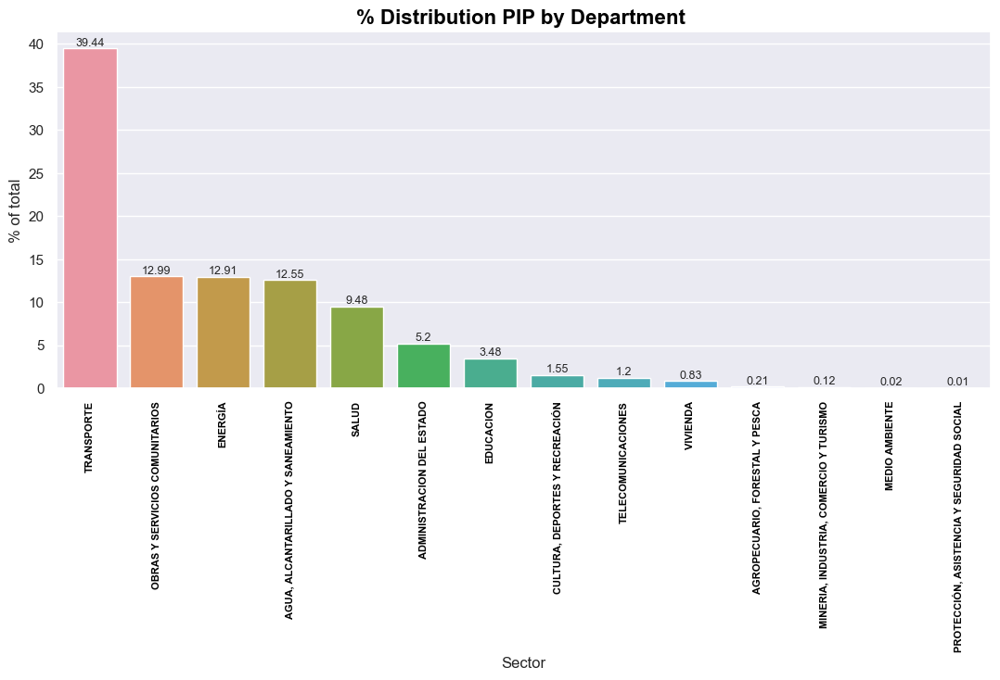

In [157]:
ds = sns.barplot(x='Sector', y='% of total', data=bysector, order=bysector.sort_values('% of total',ascending=False).Sector)
ds.set_xticklabels(ds.get_xticklabels(),rotation=90, 
                   fontdict={'fontsize':8, 'fontweight':'bold'}, color='black')
ds.set_title('% Distribution PIP by Department ', 
             fontdict={'fontsize':16, 'fontweight':'bold'}, color='black')
for container in ds.containers:
    ds.bar_label(container, fontsize=9)


**As we can see above, almost 40% of the investment went to "Transporte" sector; and with the next 3 sector (that are almost the same) it covers almos 78% of all the resources.**

## 2. Financing sources

## 2.1 What is the source type of the funding for the PIP

## The first thing is to know the origin of the source: if its internal or external source

In [373]:
funbyorig = pip_17_22.groupby(['Procedencia de la fuente'])['Monto'].sum().round(2).sort_values(ascending=False).reset_index()
funbyorig['% total'] = (100*funbyorig.Monto/funbyorig.Monto.sum()).round(2)
funbyorig

,Procedencia de la fuente,Monto,% total
0,Fondos Externos,95283.83,63.19
1,Fondos Internos,55500.63,36.81


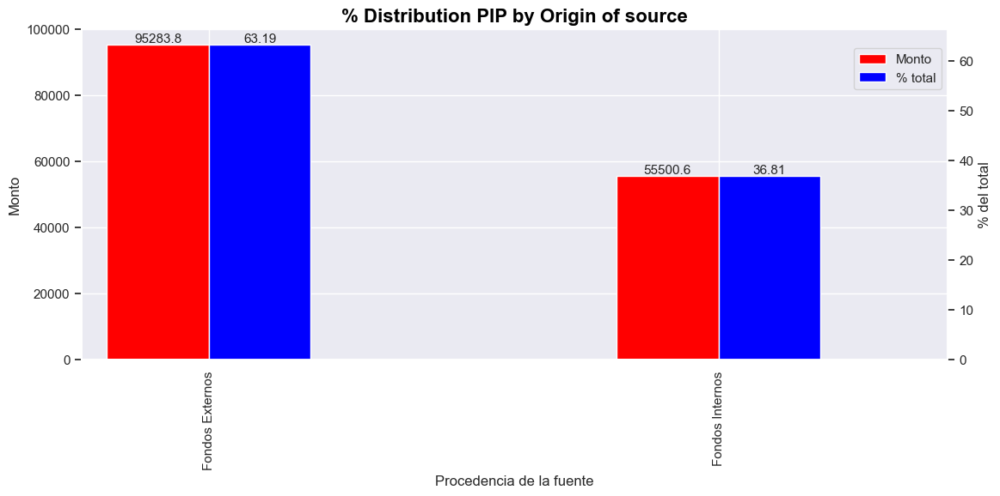

In [533]:

fig, ax = plt.subplots() # Create matplotlib figure

ax2 = ax.twinx() # Create another axes that shares the same x-axis as ax.

width = 0.2

funbyorig.plot(kind='bar', x='Procedencia de la fuente', y='Monto', color='red', width=width, ax=ax, position=1, legend=False)
funbyorig.plot(kind='bar', x='Procedencia de la fuente', y='% total', color='blue', width=width, ax=ax2, position=0, legend=False)

fig.legend(loc='upper right', bbox_to_anchor=(0.9, 0.85))

for container in ax.containers:
    ax.bar_label(container, fontsize=11)
    
for container in ax2.containers:
    ax2.bar_label(container, fontsize=11)

ax.set_ylabel('Monto')
ax2.set_ylabel('% del total')
ax2.grid(False)

ax.set_title('% Distribution PIP by Origin of source', 
             fontdict={'fontsize':16, 'fontweight':'bold'}, color='black')

plt.show()

**We can see that in the period 2017-2022 "Fondos Externos" (External fundings) is the principal origin of financial sources in the PIP, follow by the internals ("Fondos internos")**

## Now, it is necessary to know what type of funding are these externals and internals.

In [251]:
pip_17_22['Tipo de financiamiento'].unique()

['Recursos del Tesoro', 'Préstamo', 'Donación', 'Recursos Propios', 'Destino Específico']
Categories (6, object): ['Destino Específico', 'Donación', 'FALSE', 'Préstamo', 'Recursos Propios', 'Recursos del Tesoro']

### But first, is necessary to make another cleaning, since i detected a wrong category previously (FALSE)

In [252]:
pip_17_22['Tipo de financiamiento'] = pip_17_22['Tipo de financiamiento'].cat.remove_categories('FALSE')

In [439]:
typfinancount = pip_17_22['Tipo de financiamiento'].value_counts().reset_index()
typfinancount['% total'] = (100*typfinancount['Tipo de financiamiento']/typfinancount['Tipo de financiamiento'].sum()).round(2)
typfinancount

,index,Tipo de financiamiento,% total
0,Recursos del Tesoro,5690,50.75
1,Préstamo,4102,36.59
2,Donación,976,8.70
3,Recursos Propios,423,3.77
4,Destino Específico,21,0.19


**According with the above information, "Recursos del tesoro" is the most frequent type of source (50%), follow by "Préstamo" with the 36%; but know i want to know how's that reflect on amount or real sources**

In [461]:
bytip_fin = pip_17_22.groupby(['Procedencia de la fuente','Tipo de financiamiento'])['Monto'].sum().round(2).sort_values(ascending=False).reset_index()
bytip_fin['% total'] = (100*bytip_fin.Monto/bytip_fin.Monto.sum()).round(2)
bytip_fin= bytip_fin[bytip_fin['Monto'] !=0]
bytip_fin

,Procedencia de la fuente,Tipo de financiamiento,Monto,% total
0,Fondos Externos,Préstamo,87050.51,57.73
1,Fondos Internos,Recursos del Tesoro,52892.29,35.08
2,Fondos Externos,Donación,8233.32,5.46
3,Fondos Internos,Recursos Propios,2310.30,1.53
4,Fondos Internos,Destino Específico,298.04,0.20


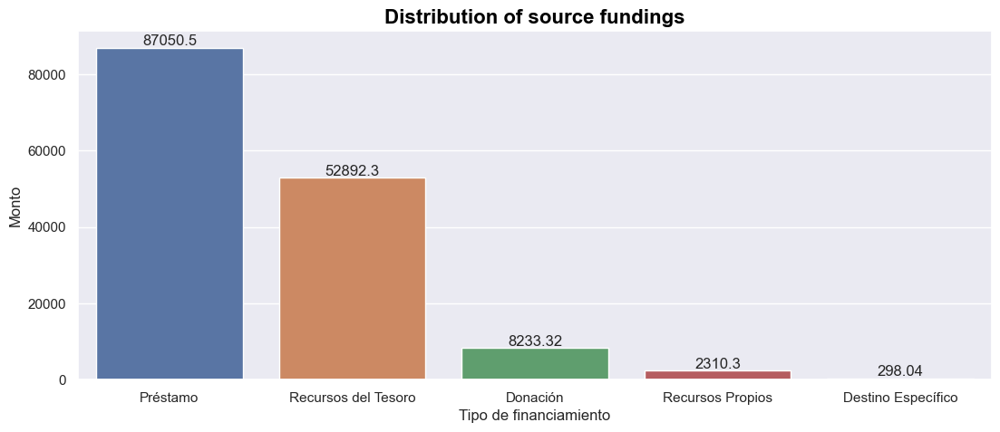

In [463]:
ac=sns.barplot(data=bytip_fin, x='Tipo de financiamiento', y='Monto',
           order=bytip_fin.sort_values('Monto',ascending=False)['Tipo de financiamiento'])
ac.set_title('Distribution of source fundings', 
             fontdict={'fontsize':16, 'fontweight':'bold'}, color='black')
for container in ac.containers:
    ac.bar_label(container, fontsize=12)

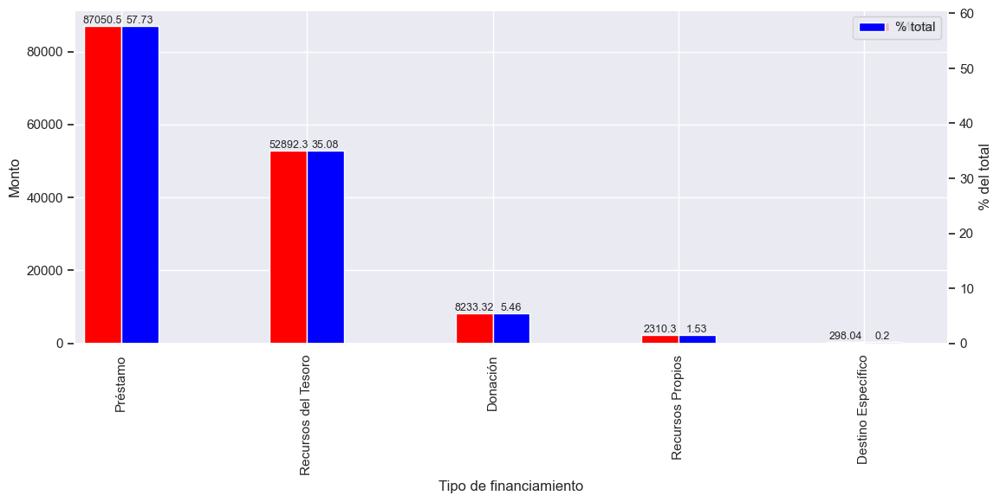

In [464]:

fig = plt.figure() # Create matplotlib figure

ax = fig.add_subplot() # Create matplotlib axes
ax2 = ax.twinx() # Create another axes that shares the same x-axis as ax.

width = 0.2

bytip_fin.plot(kind='bar', x='Tipo de financiamiento', y='Monto', color='red', width=width, ax=ax, position=1, legend=True)
bytip_fin.plot(kind='bar', x='Tipo de financiamiento', y='% total', color='blue', width=width, ax=ax2, position=0, legend=True)

for container in ax.containers:
    ax.bar_label(container, fontsize=9)
    
for container in ax2.containers:
    ax2.bar_label(container, fontsize=9)

ax.set_ylabel('Monto')
ax2.set_ylabel('% del total')
ax2.grid(False)


plt.show()

**As it shown above, "Préstamo" is the primary source of funding with the 57.73% of the total investment; it follows "Recursos del tesoro", which is a internal source; then "Donación", again an external source**

## 2.2 Individual funding sources

In [507]:
print('We can find', pip_17_22['Fuente de financiamiento'].nunique(), 'differents individual sources for the PIP')
print('The # 1 individual source is ', pip_17_22.groupby('Fuente de financiamiento')['Monto'].sum().idxmax(), 'with', pip_17_22.groupby('Fuente de financiamiento')['Monto'].sum().round(2).max())

We can find  26 differents individual sources for the PIP
The # 1 individual source is  Recursos del Tesoro with 50848.97


In [502]:
pip_17_22.groupby('Fuente de financiamiento')['Monto'].sum().idxmax()

'Recursos del Tesoro'

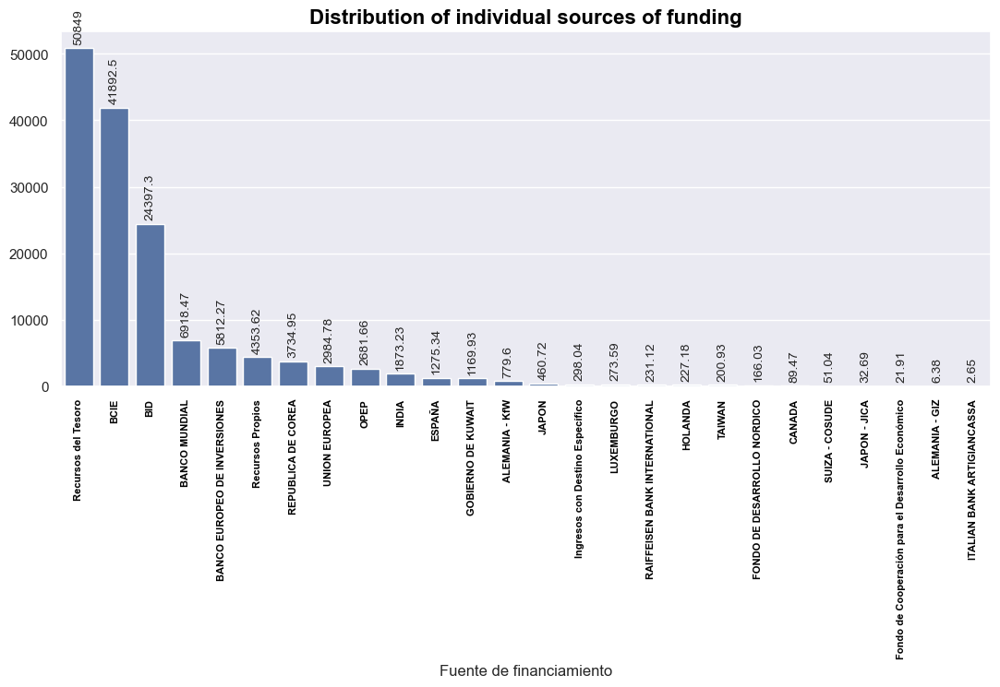

In [523]:
ordering=pip_17_22.groupby('Fuente de financiamiento')['Monto'].sum().sort_values(ascending=False).index.values
ff = sns.barplot(x=pip_17_22.groupby('Fuente de financiamiento')['Monto'].sum().round(2).index,
                y=pip_17_22.groupby('Fuente de financiamiento')['Monto'].sum().round(2).values, color="b",
                order=ordering)
ff.set_xticklabels(ff.get_xticklabels(),rotation=90, 
                   fontdict={'fontsize':8, 'fontweight':'bold'}, color='black')

ff.set_title('Distribution of individual sources of funding', 
             fontdict={'fontsize':16, 'fontweight':'bold'}, color='black')
for container in ff.containers:
    ff.bar_label(container, fontsize=10, rotation=90, padding=3)

In [528]:
fundingindividual = pip_17_22.groupby(['Fuente de financiamiento'])['Monto'].sum().round(2).sort_values(ascending=False).reset_index()
fundingindividual['% total'] = (100*fundingindividual.Monto/fundingindividual.Monto.sum()).round(2)
fundingindividual['cum %'] = fundingindividual['% total'].cumsum()
fundingindividual.head()

,Fuente de financiamiento,Monto,% total,cum %
0,Recursos del Tesoro,50848.97,33.72,33.72
1,BCIE,41892.54,27.78,61.50
2,BID,24397.35,16.18,77.68
3,BANCO MUNDIAL,6918.47,4.59,82.27
4,BANCO EUROPEO DE INVERSIONES,5812.27,3.85,86.12


**As individual source of funding we have that "Recursos del tesoro" is the one with the highest amount of resources, follow by: BCIE, BID, BANCO MUNDIAL and BANCO EUROPEO DE INVERSIONES. These 5 cumulate the 86% of the resources.**